In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt
from typing import Tuple
import torchvision.models as models
import torchvision.transforms as T
import numpy as np
import os

print("Cuda available :", torch.cuda.is_available())
print("cuda version : ", torch.backends.cudnn.version())
print("No of GPU : ", torch.cuda.device_count())
for i in range(torch.cuda.device_count()):
    print(f"Device {i} Name: ", torch.cuda.get_device_name(i))

Cuda available : True
cuda version :  8907
No of GPU :  1
Device 0 Name:  NVIDIA GeForce GTX 1650 with Max-Q Design


In [2]:
# Get image inputs and preprocess
def preprocess_images(image_path1: str, image_path2: str, height_width: int = 256) -> Tuple[torch.Tensor, torch.Tensor]:
    transform = transforms.Compose([
        transforms.Resize((height_width, height_width)),
        transforms.ToTensor()
    ])
    image1 = Image.open(image_path1).convert("RGB")
    image2 = Image.open(image_path2).convert("RGB")
    print("Shape of Image 1: ", image1.size)
    print("Shape of Image 2: ", image2.size)
    image1 = transform(image1)
    image2 = transform(image2)
    print("Shape of Reshaped Image 1: ", image1.shape)
    print("Shape of Reshaped Image 2: ", image2.shape)
    return image1, image2

def show_image(image: torch.Tensor) -> None:
    image_np = image.squeeze().detach().numpy()
    image_np = image_np.transpose(1, 2, 0)  # (C, H, W) -> (H, W, C)
    plt.imshow(image_np)
    plt.axis('off')

# Define a function to display an image on a given axis
def plot_image(ax, image: torch.Tensor, title: str):
    image_np = image.squeeze().detach().numpy()
    image_np = image_np.transpose(1, 2, 0)  # (C, H, W) -> (H, W, C)
    ax.imshow(image_np)
    ax.set_title(title)
    ax.axis('off')

image_path1 = './original_images/ILSVRC2017_test_00000025.JPEG'
image_path2 = './original_images/ILSVRC2017_test_00000034.JPEG'
img1, img2 = preprocess_images(image_path1, image_path2)

Shape of Image 1:  (256, 256)
Shape of Image 2:  (256, 256)
Shape of Reshaped Image 1:  torch.Size([3, 256, 256])
Shape of Reshaped Image 2:  torch.Size([3, 256, 256])


In [3]:
def calculate_mean_pixel_difference(image1: torch.Tensor, image2: torch.Tensor, absolute: bool = True) -> float:
    if image1.shape != image2.shape:
        raise ValueError("Error: Tensors must have the same shape.")
    difference = image1 - image2
    if absolute:
        mean_difference = torch.mean(torch.abs(difference))
    else:
        mean_difference = torch.mean(difference ** 2)
    return mean_difference.item()  

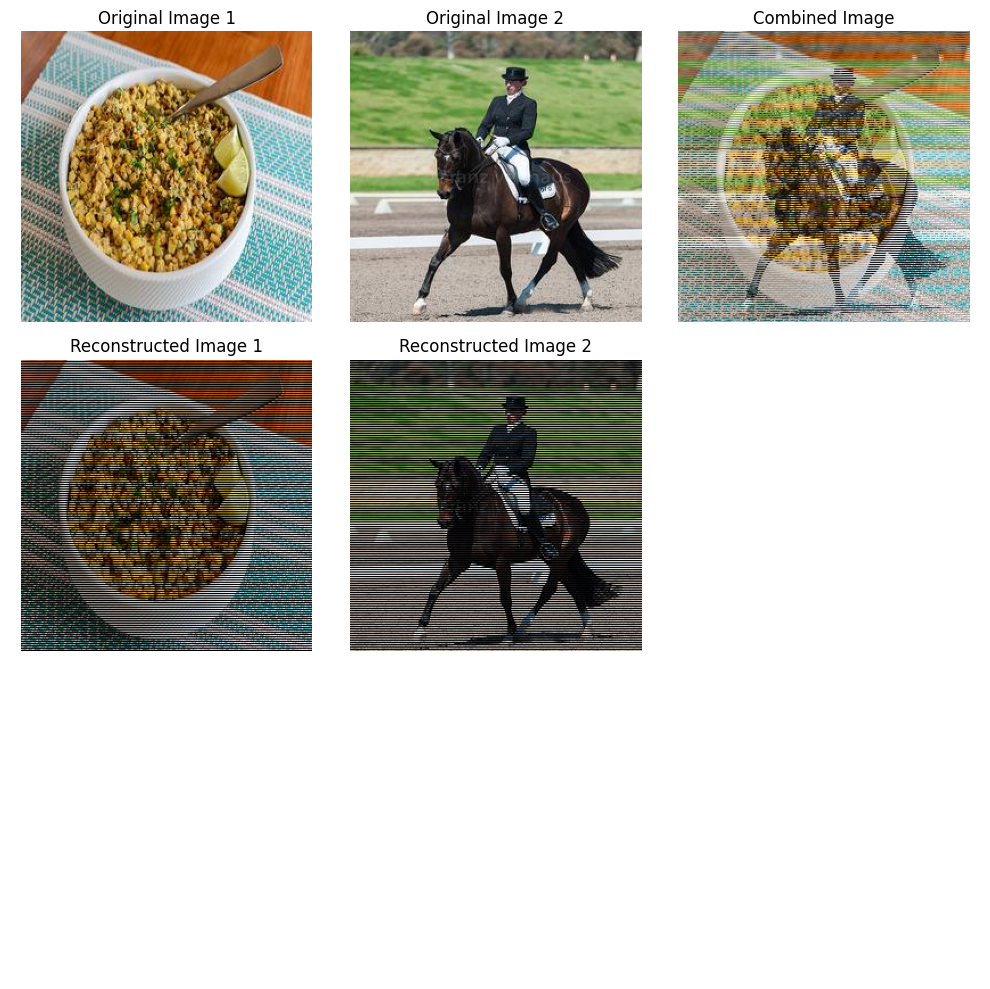

In [4]:
### ROW WISE Fusing

# Function to combine images pixel-wise
def combine_images_row_wise(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    combined_image_row_wise = torch.zeros_like(img1)
    combined_image_row_wise[:, ::2, :] = img1[:, ::2, :]
    combined_image_row_wise[:, 1::2, :] = img2[:, 1::2, :]
    return combined_image_row_wise

# Function to reconstruct images from combined image
def reconstruct_images_row_wise(combined_image_row_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    img1_reconstructed_row_wise = torch.zeros_like(combined_image_row_wise)
    img2_reconstructed_row_wise = torch.zeros_like(combined_image_row_wise)
    img1_reconstructed_row_wise[:, ::2, :] = combined_image_row_wise[:, ::2, :]
    img2_reconstructed_row_wise[:, 1::2, :] = combined_image_row_wise[:, 1::2, :]
    return img1_reconstructed_row_wise, img2_reconstructed_row_wise


combined_image_row_wise = combine_images_row_wise(img1, img2)
img1_reconstructed_row_wise, img2_reconstructed_row_wise = reconstruct_images_row_wise(combined_image_row_wise)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], combined_image_row_wise, "Combined Image")
plot_image(axes[1][0], img1_reconstructed_row_wise, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_row_wise, "Reconstructed Image 2")
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

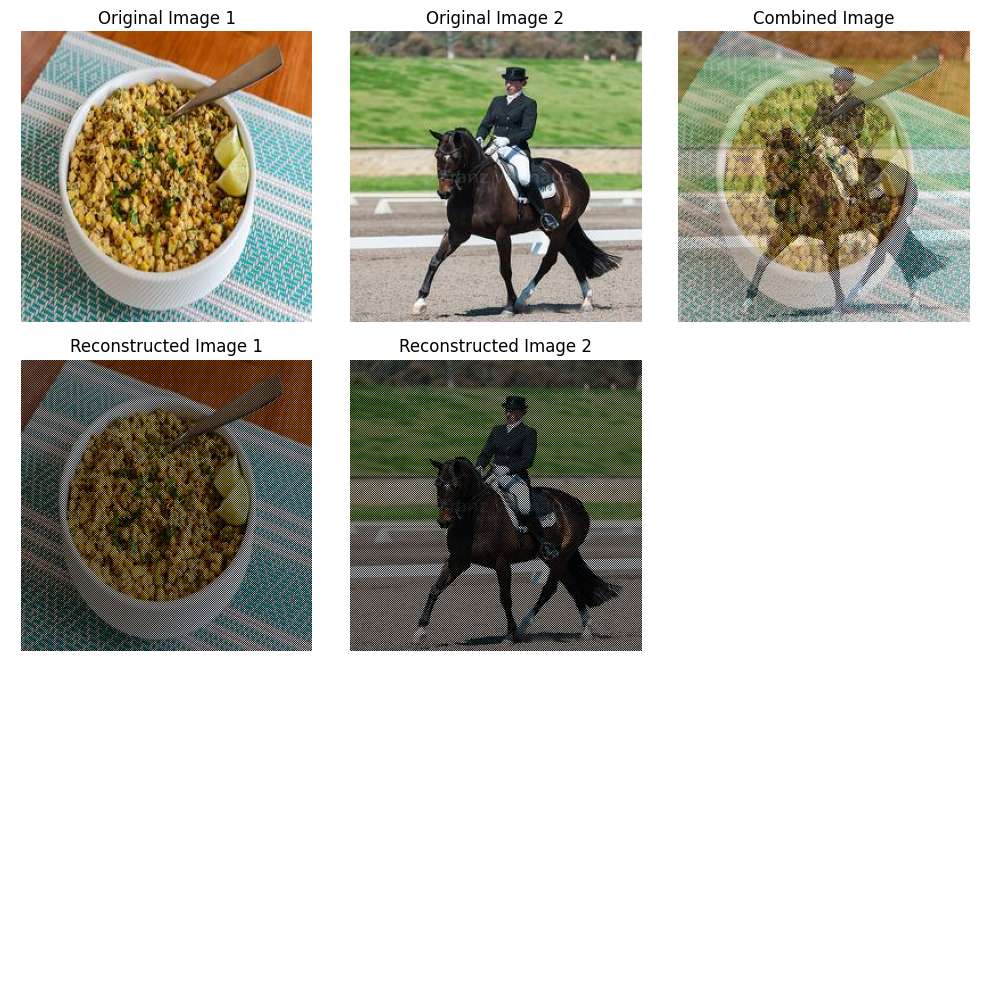

In [5]:
### PIXEL WISE Fusing

# Function to combine images pixel-wise with alternating pattern
def combine_images_pixel_wise(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    combined_image_pixel_wise = torch.zeros_like(img1)
    combined_image_pixel_wise[:, 0::2, ::2] = img1[:, 0::2, ::2]    # img1 even rows, even cols
    combined_image_pixel_wise[:, 0::2, 1::2] = img2[:, 0::2, 1::2]  # img2 even rows, odd cols
    combined_image_pixel_wise[:, 1::2, ::2] = img2[:, 1::2, ::2]    # img2 odd rows, even cols
    combined_image_pixel_wise[:, 1::2, 1::2] = img1[:, 1::2, 1::2]  # img1 odd rows, odd cols
    return combined_image_pixel_wise

# Function to reconstruct images from combined image
def reconstruct_images_pixel_wise(combined_image_pixel_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    img1_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img2_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img1_reconstructed_pixel_wise[:, 0::2, ::2] = combined_image_pixel_wise[:, 0::2, ::2]
    img2_reconstructed_pixel_wise[:, 0::2, 1::2] = combined_image_pixel_wise[:, 0::2, 1::2]
    img2_reconstructed_pixel_wise[:, 1::2, ::2] = combined_image_pixel_wise[:, 1::2, ::2]
    img1_reconstructed_pixel_wise[:, 1::2, 1::2] = combined_image_pixel_wise[:, 1::2, 1::2]
    return img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise


combined_image_pixel_wise = combine_images_pixel_wise(img1, img2)
img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(combined_image_pixel_wise)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], combined_image_pixel_wise, "Combined Image")
plot_image(axes[1][0], img1_reconstructed_pixel_wise, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_pixel_wise, "Reconstructed Image 2")
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [6]:
# Refinement functions

# Function to apply Gaussian smoothing - TESTED
def apply_gaussian_smoothing(image: torch.Tensor, kernel_size: int = 3, sigma: float = 1.0) -> torch.Tensor:
    gaussian_blur = T.GaussianBlur(kernel_size=kernel_size, sigma=sigma)
    smoothed_image = gaussian_blur(image)
    return smoothed_image

# Function to apply Bilinear Interpolation - TESTED
def apply_bilinear_interpolation(image: torch.Tensor, scale_factor: float = 1.0) -> torch.Tensor:
    if scale_factor != 1.0:
        image = F.interpolate(image.unsqueeze(0), scale_factor=scale_factor, mode='bilinear', align_corners=True)
        image = F.interpolate(image, size=(256, 256), mode='bilinear', align_corners=True)  
        return image.squeeze(0)  
    return image

#bicubid interpollation - TESTED
def apply_bicubic_interpolation(image: torch.Tensor, scale_factor: float = 1.0, target_size: Tuple[int, int] = None) -> torch.Tensor:
    image = image.unsqueeze(0) 
    if target_size is not None:
        resized_image = F.interpolate(image, size=target_size, mode='bicubic', align_corners=True)
    else:
        resized_image = F.interpolate(image, scale_factor=scale_factor, mode='bicubic', align_corners=True)
    return resized_image.squeeze(0)  

# Function to apply Median Filtering
def apply_median_filtering(image: torch.Tensor, kernel_size: int = 3) -> torch.Tensor:
    image = image.unsqueeze(0) 
    median_filtered_image = F.median_blur(image, kernel_size=kernel_size)
    return median_filtered_image.squeeze(0)  

# def apply_median_filtering(image: torch.Tensor, kernel_size: int = 3) -> torch.Tensor:
#     image_np = image.permute(1, 2, 0).cpu().numpy()
#     median_filtered_np = np.stack([cv2.medianBlur(image_np[:, :, i], kernel_size) for i in range(image_np.shape[2])], axis=2)
#     median_filtered_image = torch.from_numpy(median_filtered_np).permute(2, 0, 1)
#     return median_filtered_image.to(image.device)

# Function to apply Laplacian Sharpening
def apply_laplacian_sharpening(image: torch.Tensor) -> torch.Tensor:
    laplacian_kernel = torch.tensor([[0, -1, 0],
                                     [-1, 4, -1],
                                     [0, -1, 0]]).float().unsqueeze(0).unsqueeze(0)
    laplacian_kernel = laplacian_kernel.to(image.device)  
    channels = []
    for c in range(image.size(0)):
        channel = image[c:c+1].unsqueeze(0)  
        channel_filtered = F.conv2d(channel, laplacian_kernel, padding=1)
        channels.append(channel_filtered)
    sharpened_image = torch.cat(channels, dim=1).squeeze(0)  
    sharpened_image = torch.clamp(image + sharpened_image, 0, 1)
    return sharpened_image

# Function to apply Super-Resolution (Using a Pre-Trained Model)
def apply_super_resolution(image: torch.Tensor, upscale_factor: int = 2) -> torch.Tensor:
    model = models.srresnet(pretrained=True)
    model.eval()  
    with torch.no_grad():
        image_upscaled = model(image.unsqueeze(0))
    return image_upscaled.squeeze(0)  

# Function to adjust the brightness of an image
def adjust_brightness(image: torch.Tensor, brightness_factor: float) -> torch.Tensor:
    brightened_image = torch.clamp(image * brightness_factor, 0, 1)
    return brightened_image

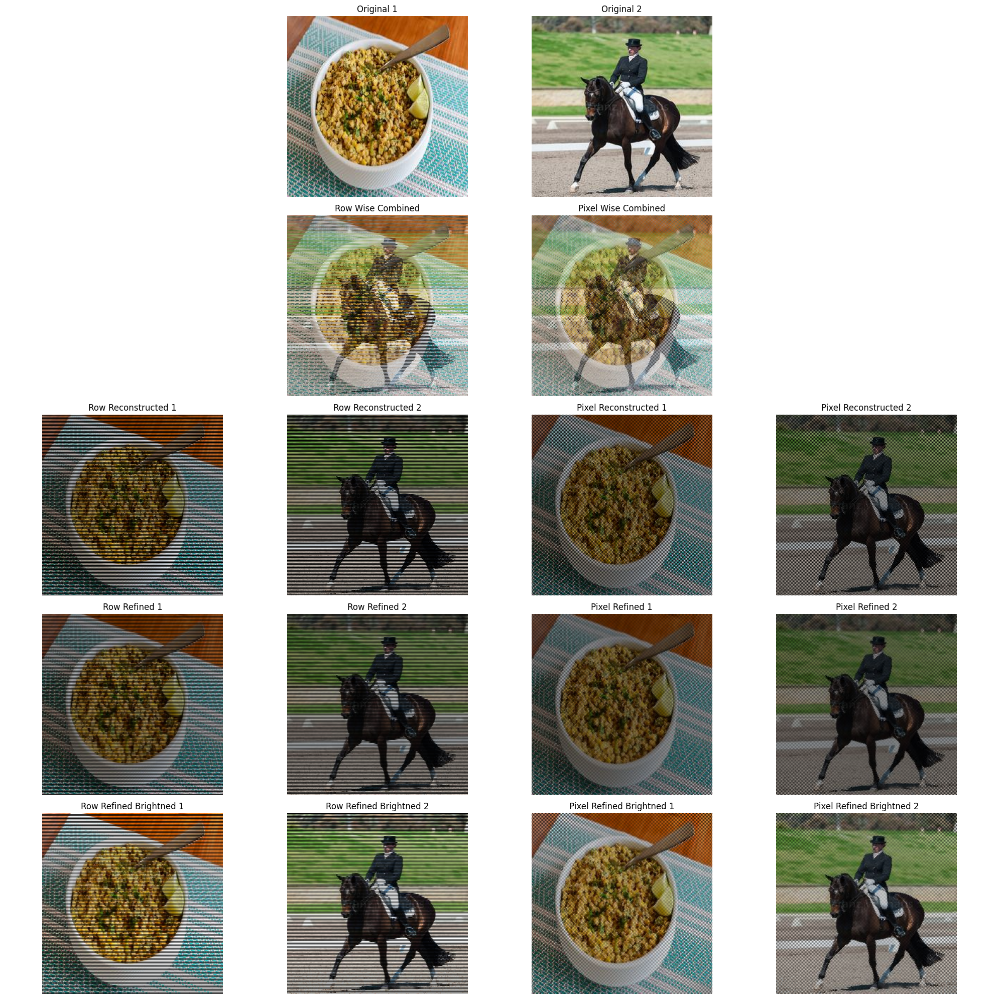

In [7]:
# Apply Bilinear interpollation to the reconstructed images

brightness_factor=1.5
img1_reconstructed_row_wise_bilinear_interpolation = apply_bilinear_interpolation(img1_reconstructed_row_wise, scale_factor=2.0)
img2_reconstructed_row_wise_bilinear_interpolation = apply_bilinear_interpolation(img2_reconstructed_row_wise, scale_factor=2.0)
img1_reconstructed_pixel_wise_bilinear_interpolation = apply_bilinear_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0)
img2_reconstructed_pixel_wise_bilinear_interpolation = apply_bilinear_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0)
img1_reconstructed_row_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img1_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_row_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img2_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img1_reconstructed_pixel_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_pixel_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)

# Plot images in a row
fig, axes = plt.subplots(5, 4, figsize=(20,20))

# Plot each image with its title
plot_image(axes[0][1], img1, "Original 1")
plot_image(axes[0][2], img2, "Original 2")
plot_image(axes[1][1], combined_image_row_wise, "Row Wise Combined")
plot_image(axes[1][2], combined_image_pixel_wise, "Pixel Wise Combined")

plot_image(axes[2][0], img1_reconstructed_row_wise, "Row Reconstructed 1")
plot_image(axes[2][1], img2_reconstructed_row_wise, "Row Reconstructed 2")
plot_image(axes[2][2], img1_reconstructed_pixel_wise, "Pixel Reconstructed 1")
plot_image(axes[2][3], img2_reconstructed_pixel_wise, "Pixel Reconstructed 2")

plot_image(axes[3][0], img1_reconstructed_row_wise_bilinear_interpolation, "Row Refined 1")
plot_image(axes[3][1], img2_reconstructed_row_wise_bilinear_interpolation, "Row Refined 2")
plot_image(axes[3][2], img1_reconstructed_pixel_wise_bilinear_interpolation, "Pixel Refined 1")
plot_image(axes[3][3], img2_reconstructed_pixel_wise_bilinear_interpolation, "Pixel Refined 2")

plot_image(axes[4][0], img1_reconstructed_row_wise_bilinear_interpolation_brightned, "Row Refined Brightned 1")
plot_image(axes[4][1], img2_reconstructed_row_wise_bilinear_interpolation_brightned, "Row Refined Brightned 2")
plot_image(axes[4][2], img1_reconstructed_pixel_wise_bilinear_interpolation_brightned, "Pixel Refined Brightned 1")
plot_image(axes[4][3], img2_reconstructed_pixel_wise_bilinear_interpolation_brightned, "Pixel Refined Brightned 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [8]:
print("Bilinear Interpollation Refinement")
pixel_diff_bilinear_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bilinear_interpolation, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_bilinear_1)
absolute_diff_bilinear_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bilinear_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_bilinear_1)
pixel_diff_bilinear_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bilinear_interpolation, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_bilinear_2)
absolute_diff_bilinear_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bilinear_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_bilinear_2)

Bilinear Interpollation Refinement
Pixel Differences Tensor of image 1: 0.10975214838981628
Absolute Pixel Differences Tensor of image 1: 0.26866745948791504
Pixel Differences Tensor of image 2: 0.099092997610569
Absolute Pixel Differences Tensor of image 2: 0.2547042667865753


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.10040285..1.0409131].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.11133134..1.0312126].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.027443059..0.99988264].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.02187468..0.9875146].


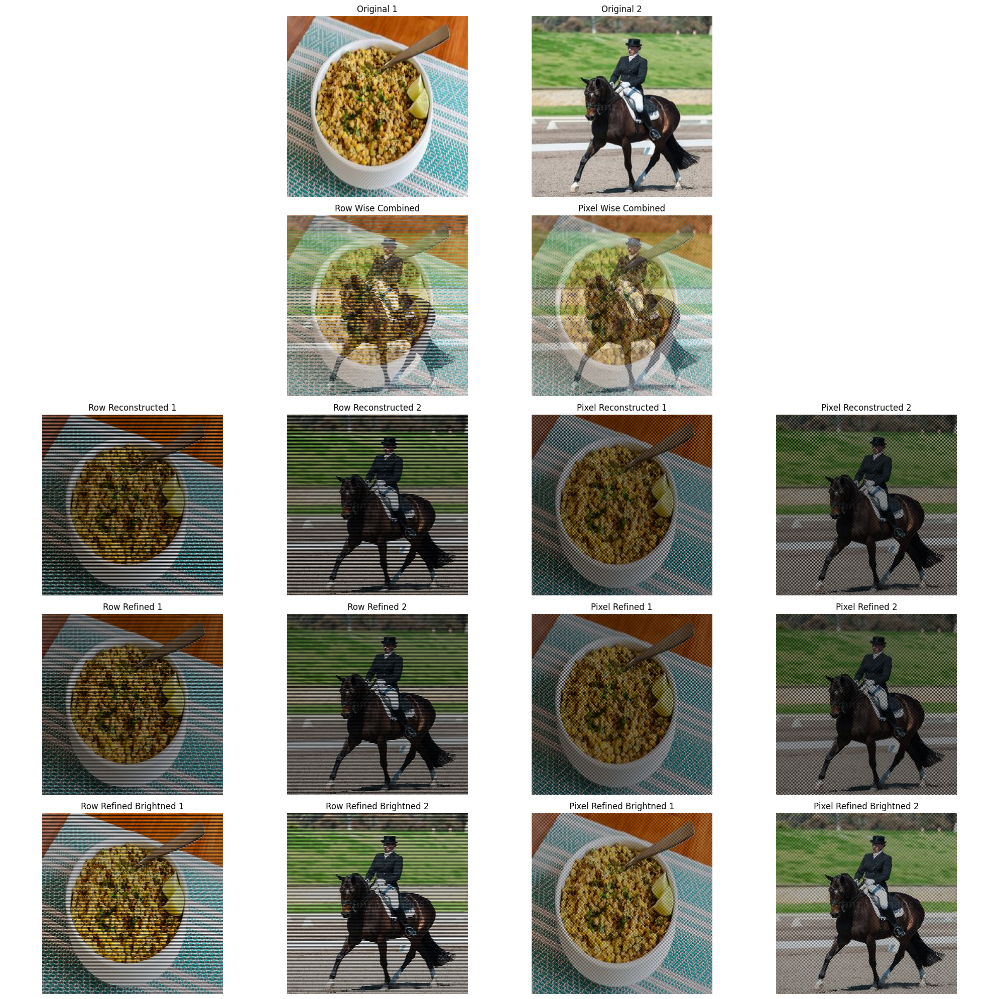

In [9]:
# Apply Bicubic interpollation to the reconstructed images

brightness_factor=1.5
img1_reconstructed_row_wise_bicubic_interpolation = apply_bicubic_interpolation(img1_reconstructed_row_wise, scale_factor=2.0)
img2_reconstructed_row_wise_bicubic_interpolation = apply_bicubic_interpolation(img2_reconstructed_row_wise, scale_factor=2.0)
img1_reconstructed_pixel_wise_bicubic_interpolation = apply_bicubic_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0)
img2_reconstructed_pixel_wise_bicubic_interpolation = apply_bicubic_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0)

# Resize the bicubic interpolated images back to original size
target_size = (256, 256)
img1_reconstructed_pixel_wise_bicubic_interpolation = F.interpolate(img1_reconstructed_pixel_wise_bicubic_interpolation.unsqueeze(0), size=target_size, mode='bicubic', align_corners=True).squeeze(0)
img2_reconstructed_pixel_wise_bicubic_interpolation = F.interpolate(img2_reconstructed_pixel_wise_bicubic_interpolation.unsqueeze(0), size=target_size, mode='bicubic', align_corners=True).squeeze(0)

img1_reconstructed_row_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img1_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_row_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img2_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img1_reconstructed_pixel_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_pixel_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)

# Plot images in a row
fig, axes = plt.subplots(5, 4, figsize=(20,20))

# Plot each image with its title
plot_image(axes[0][1], img1, "Original 1")
plot_image(axes[0][2], img2, "Original 2")
plot_image(axes[1][1], combined_image_row_wise, "Row Wise Combined")
plot_image(axes[1][2], combined_image_pixel_wise, "Pixel Wise Combined")

plot_image(axes[2][0], img1_reconstructed_row_wise, "Row Reconstructed 1")
plot_image(axes[2][1], img2_reconstructed_row_wise, "Row Reconstructed 2")
plot_image(axes[2][2], img1_reconstructed_pixel_wise, "Pixel Reconstructed 1")
plot_image(axes[2][3], img2_reconstructed_pixel_wise, "Pixel Reconstructed 2")

plot_image(axes[3][0], img1_reconstructed_row_wise_bicubic_interpolation, "Row Refined 1")
plot_image(axes[3][1], img2_reconstructed_row_wise_bicubic_interpolation, "Row Refined 2")
plot_image(axes[3][2], img1_reconstructed_pixel_wise_bicubic_interpolation, "Pixel Refined 1")
plot_image(axes[3][3], img2_reconstructed_pixel_wise_bicubic_interpolation, "Pixel Refined 2")

plot_image(axes[4][0], img1_reconstructed_row_wise_bicubic_interpolation_brightned, "Row Refined Brightned 1")
plot_image(axes[4][1], img2_reconstructed_row_wise_bicubic_interpolation_brightned, "Row Refined Brightned 2")
plot_image(axes[4][2], img1_reconstructed_pixel_wise_bicubic_interpolation_brightned, "Pixel Refined Brightned 1")
plot_image(axes[4][3], img2_reconstructed_pixel_wise_bicubic_interpolation_brightned, "Pixel Refined Brightned 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [10]:
print("Bicubic Interpollation Refinement")
pixel_diff_bicubic_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bicubic_interpolation, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_bicubic_1)
absolute_diff_bicubic_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bicubic_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_bicubic_1)
pixel_diff_bicubic_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bicubic_interpolation, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_bicubic_2)
absolute_diff_bicubic_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bicubic_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_bicubic_2)

Bicubic Interpollation Refinement
Pixel Differences Tensor of image 1: 0.1675727814435959
Absolute Pixel Differences Tensor of image 1: 0.26802316308021545
Pixel Differences Tensor of image 2: 0.15148688852787018
Absolute Pixel Differences Tensor of image 2: 0.2543882429599762


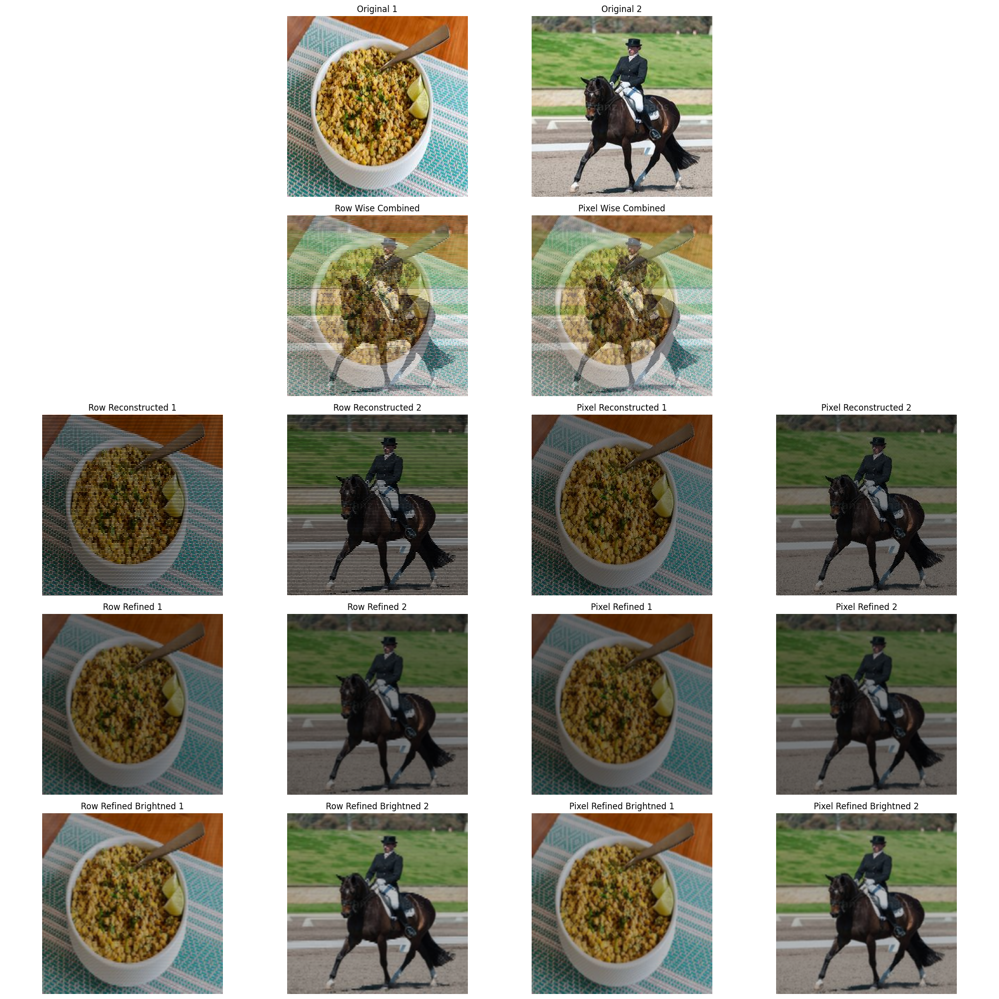

In [11]:
# Apply Gaussian Smoothig to the reconstructed images

brightness_factor=1.5
img1_reconstructed_row_wise_gaussian_smoothing = apply_gaussian_smoothing(img1_reconstructed_row_wise, kernel_size=3)
img2_reconstructed_row_wise_gaussian_smoothing = apply_gaussian_smoothing(img2_reconstructed_row_wise, kernel_size=3)
img1_reconstructed_pixel_wise_gaussian_smoothing = apply_gaussian_smoothing(img1_reconstructed_pixel_wise, kernel_size=3)
img2_reconstructed_pixel_wise_gaussian_smoothing = apply_gaussian_smoothing(img2_reconstructed_pixel_wise, kernel_size=3)
img1_reconstructed_row_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img1_reconstructed_row_wise, kernel_size=3),brightness_factor)
img2_reconstructed_row_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img2_reconstructed_row_wise, kernel_size=3),brightness_factor)
img1_reconstructed_pixel_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img1_reconstructed_pixel_wise, kernel_size=3),brightness_factor)
img2_reconstructed_pixel_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img2_reconstructed_pixel_wise, kernel_size=3),brightness_factor)

# Plot images in a row
fig, axes = plt.subplots(5, 4, figsize=(20,20))

# Plot each image with its title
plot_image(axes[0][1], img1, "Original 1")
plot_image(axes[0][2], img2, "Original 2")
plot_image(axes[1][1], combined_image_row_wise, "Row Wise Combined")
plot_image(axes[1][2], combined_image_pixel_wise, "Pixel Wise Combined")

plot_image(axes[2][0], img1_reconstructed_row_wise, "Row Reconstructed 1")
plot_image(axes[2][1], img2_reconstructed_row_wise, "Row Reconstructed 2")
plot_image(axes[2][2], img1_reconstructed_pixel_wise, "Pixel Reconstructed 1")
plot_image(axes[2][3], img2_reconstructed_pixel_wise, "Pixel Reconstructed 2")

plot_image(axes[3][0], img1_reconstructed_row_wise_gaussian_smoothing, "Row Refined 1")
plot_image(axes[3][1], img2_reconstructed_row_wise_gaussian_smoothing, "Row Refined 2")
plot_image(axes[3][2], img1_reconstructed_pixel_wise_gaussian_smoothing, "Pixel Refined 1")
plot_image(axes[3][3], img2_reconstructed_pixel_wise_gaussian_smoothing, "Pixel Refined 2")

plot_image(axes[4][0], img1_reconstructed_row_wise_gaussian_smoothing_brightned, "Row Refined Brightned 1")
plot_image(axes[4][1], img2_reconstructed_row_wise_gaussian_smoothing_brightned, "Row Refined Brightned 2")
plot_image(axes[4][2], img1_reconstructed_pixel_wise_gaussian_smoothing_brightned, "Pixel Refined Brightned 1")
plot_image(axes[4][3], img2_reconstructed_pixel_wise_gaussian_smoothing_brightned, "Pixel Refined Brightned 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [12]:
print("Gaussian Smoothing Refinement")
print(img1.size())
print(img1_reconstructed_pixel_wise_gaussian_smoothing.size())
pixel_diff_gaussian_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_gaussian_smoothing, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_gaussian_1)
absolute_diff_gaussian_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_gaussian_smoothing, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_gaussian_1)
pixel_diff_gaussian_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_gaussian_smoothing, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_gaussian_2)
absolute_diff_gaussian_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_gaussian_smoothing, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_gaussian_2)

Gaussian Smoothing Refinement
torch.Size([3, 256, 256])
torch.Size([3, 256, 256])
Pixel Differences Tensor of image 1: 0.09259074181318283
Absolute Pixel Differences Tensor of image 1: 0.27010491490364075
Pixel Differences Tensor of image 2: 0.0817006453871727
Absolute Pixel Differences Tensor of image 2: 0.255634069442749


In [13]:
# 4NN Refinement
def replace_missing_pixels_with_neighbors(image_tensor: torch.Tensor, secret_image_number: int) -> torch.Tensor:
    channels, height, width = image_tensor.shape
    filled_image = image_tensor.clone()
    for i in range(height):
        for j in range(width):
            if secret_image_number == 1:
                if (i % 2 == 0 and j % 2 == 0) or (i % 2 == 1 and j % 2 == 1):
                    continue  
            elif secret_image_number == 2:
                if (i % 2 == 0 and j % 2 == 1) or (i % 2 == 1 and j % 2 == 0):
                    continue  
            if torch.all(filled_image[:, i, j] == 0):
                neighbors = []
                if i - 1 >= 0 and torch.any(filled_image[:, i - 1, j] != 0):
                    neighbors.append(filled_image[:, i - 1, j])
                if i + 1 < height and torch.any(filled_image[:, i + 1, j] != 0):
                    neighbors.append(filled_image[:, i + 1, j])
                if j - 1 >= 0 and torch.any(filled_image[:, i, j - 1] != 0):
                    neighbors.append(filled_image[:, i, j - 1])
                if j + 1 < width and torch.any(filled_image[:, i, j + 1] != 0):
                    neighbors.append(filled_image[:, i, j + 1])
                if neighbors:
                    filled_image[:, i, j] = torch.mean(torch.stack(neighbors), dim=0)
    return filled_image

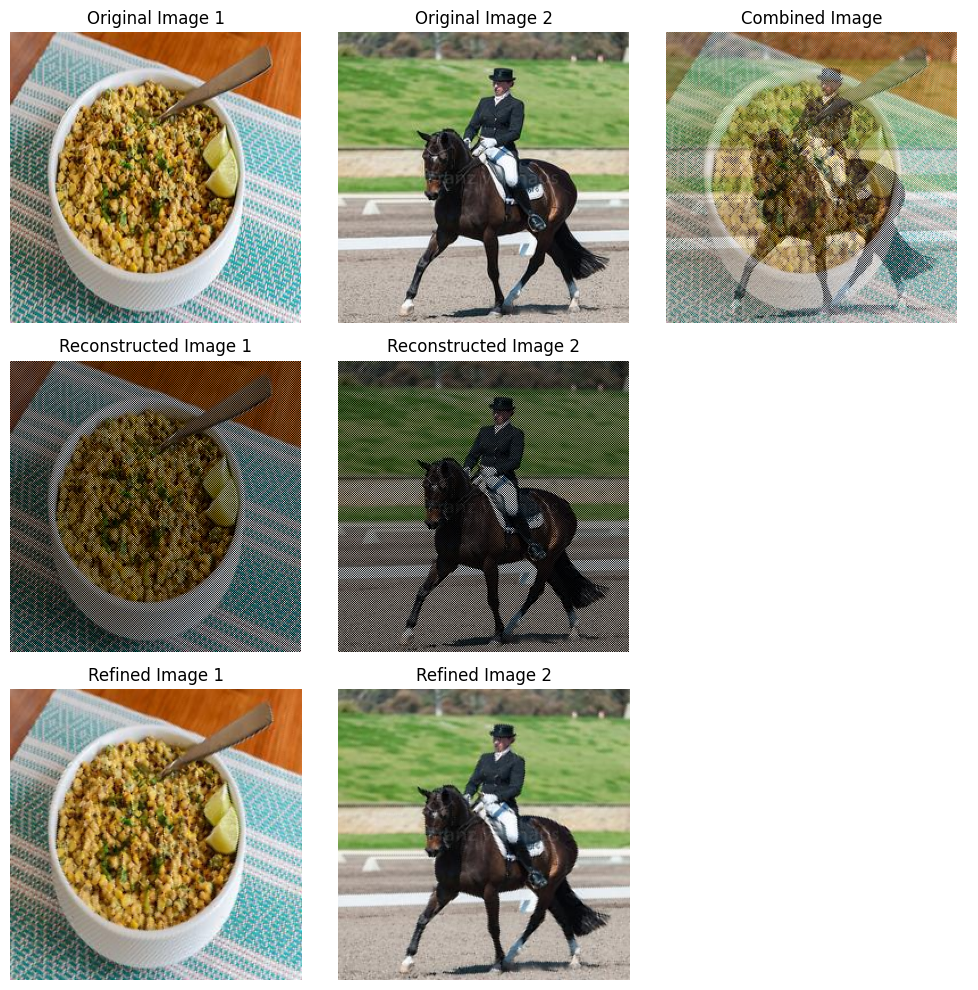

In [14]:
img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], combined_image_pixel_wise, "Combined Image")
plot_image(axes[1][0], img1_reconstructed_pixel_wise, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_pixel_wise, "Reconstructed Image 2")
plot_image(axes[2][0], img1_NN_refined_pixel_wise, "Refined Image 1")
plot_image(axes[2][1], img2_NN_refined_pixel_wise, "Refined Image 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [15]:
print("4 Nearest Neighbor Refinement")
pixel_diff_4nn_1 = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_4nn_1)
absolute_diff_4nn_1 = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_4nn_1)
pixel_diff_4nn_2 = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_4nn_2)
absolute_diff_4nn_2 = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_4nn_2)

4 Nearest Neighbor Refinement
Pixel Differences Tensor of image 1: 0.0026690245140343904
Absolute Pixel Differences Tensor of image 1: 0.025279873982071877
Pixel Differences Tensor of image 2: 0.0010932799195870757
Absolute Pixel Differences Tensor of image 2: 0.012276649475097656


In [16]:
### PIXEL WISE WITH MSB TECHNIQUE

# Function to load and preprocess images
def load_image_msb(image_path: str, size=(256, 256)) -> torch.Tensor:
    image = Image.open(image_path).convert("RGB")  
    transform = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor(),  
    ])
    image_tensor = transform(image) * 255  
    return image_tensor.to(torch.uint8)

# Function to display an image
def plot_image_msb(ax, image: torch.Tensor, title: str):
    image_np = image.permute(1, 2, 0).byte().numpy()  
    ax.imshow(image_np)
    ax.set_title(title)
    ax.axis('off')  

# Combining images using MSB
def combine_images_pixel_wise_msb(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    img1 = img1.to(torch.uint8)
    img2 = img2.to(torch.uint8)
    combined_image_pixel_wise = torch.zeros_like(img1)
    img1_msb = img1 & 0xF0  
    img2_msb = img2 & 0xF0 
    combined_image_pixel_wise[:, ::2, ::2] = (img1_msb[:, ::2, ::2] | (img2_msb[:, ::2, ::2] >> 4))      # even row, even col
    combined_image_pixel_wise[:, ::2, 1::2] = (img2_msb[:, ::2, 1::2] | (img1_msb[:, ::2, 1::2] >> 4))   # even row, odd col
    combined_image_pixel_wise[:, 1::2, ::2] = (img2_msb[:, 1::2, ::2] | (img1_msb[:, 1::2, ::2] >> 4))   # odd row, even col
    combined_image_pixel_wise[:, 1::2, 1::2] = (img1_msb[:, 1::2, 1::2] | (img2_msb[:, 1::2, 1::2] >> 4))# odd row, odd col
    return combined_image_pixel_wise

# Reconstructing images from combined image
def reconstruct_images_pixel_wise_msb(combined_image_pixel_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    combined_image_pixel_wise = combined_image_pixel_wise.to(torch.uint8)
    img1_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img2_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img1_reconstructed_pixel_wise[:, ::2, ::2] = combined_image_pixel_wise[:, ::2, ::2] & 0xF0             # even row, even col
    img2_reconstructed_pixel_wise[:, ::2, ::2] = (combined_image_pixel_wise[:, ::2, ::2] & 0x0F) << 4      # even row, even col
    img2_reconstructed_pixel_wise[:, ::2, 1::2] = combined_image_pixel_wise[:, ::2, 1::2] & 0xF0           # even row, odd col
    img1_reconstructed_pixel_wise[:, ::2, 1::2] = (combined_image_pixel_wise[:, ::2, 1::2] & 0x0F) << 4    # even row, odd col
    img2_reconstructed_pixel_wise[:, 1::2, ::2] = combined_image_pixel_wise[:, 1::2, ::2] & 0xF0           # odd row, even col
    img1_reconstructed_pixel_wise[:, 1::2, ::2] = (combined_image_pixel_wise[:, 1::2, ::2] & 0x0F) << 4    # odd row, even col
    img1_reconstructed_pixel_wise[:, 1::2, 1::2] = combined_image_pixel_wise[:, 1::2, 1::2] & 0xF0         # odd row, odd col
    img2_reconstructed_pixel_wise[:, 1::2, 1::2] = (combined_image_pixel_wise[:, 1::2, 1::2] & 0x0F) << 4  # odd row, odd col
    return img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise

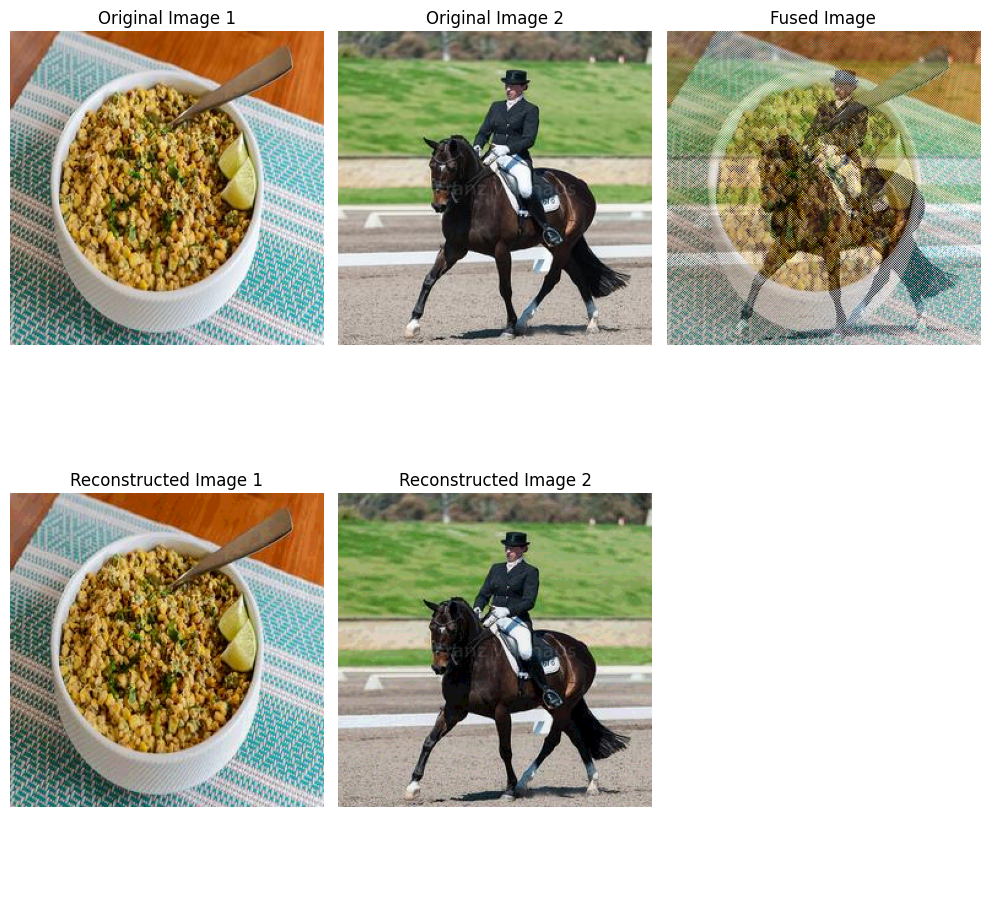

In [17]:
img1_msb = load_image_msb(image_path1)
img2_msb = load_image_msb(image_path2)
fused_image_msb = combine_images_pixel_wise_msb(img1_msb, img2_msb)
img1_reconstructed_msb, img2_reconstructed_msb = reconstruct_images_pixel_wise_msb(fused_image_msb)
fig, axes = plt.subplots(2, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], fused_image_msb, "Fused Image")
plot_image(axes[1][0], img1_reconstructed_msb, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_msb, "Reconstructed Image 2")
# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

In [18]:
print("LSB Manipulation")
pixel_diff_msb_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_msb, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_msb_1)
absolute_diff_msb_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_msb, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_msb_1)
pixel_diff_msb_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_msb, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_msb_2)
absolute_diff_msb_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_msb, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_msb_2)

LSB Manipulation
Pixel Differences Tensor of image 1: 20775.6640625
Absolute Pixel Differences Tensor of image 1: 128.78721618652344
Pixel Differences Tensor of image 2: 18694.072265625
Absolute Pixel Differences Tensor of image 2: 121.73780059814453


In [19]:
from tabulate import tabulate

# Gather results in a list format
results = [
    ["Image 1 : Mean Pixel Difference", pixel_diff_4nn_1, pixel_diff_msb_1, pixel_diff_bilinear_1, pixel_diff_bicubic_1, pixel_diff_gaussian_1],
    ["Image 1 : Absolute Pixel Difference", absolute_diff_4nn_1, absolute_diff_msb_1, absolute_diff_bilinear_1, absolute_diff_bicubic_1, absolute_diff_gaussian_1],
    ["Image 2 : Mean Pixel Difference", pixel_diff_4nn_2, pixel_diff_msb_2, pixel_diff_bilinear_2, pixel_diff_bicubic_2, pixel_diff_gaussian_2],
    ["Image 2 : Absolute Pixel Difference", absolute_diff_4nn_2, absolute_diff_msb_2, absolute_diff_bilinear_2, absolute_diff_bicubic_2, absolute_diff_gaussian_2],
]

# Define headers
headers = ["Image", "4NN Refinement", "LSB Manipulation", "Bilinear Refinement", "Bicubic Refinement", "Gaussian Refinement", ]

# Print the table
print(tabulate(results, headers=headers, tablefmt="grid"))

+-------------------------------------+------------------+--------------------+-----------------------+----------------------+-----------------------+
| Image                               |   4NN Refinement |   LSB Manipulation |   Bilinear Refinement |   Bicubic Refinement |   Gaussian Refinement |
+=====================================+==================+====================+=======================+======================+=======================+
| Image 1 : Mean Pixel Difference     |       0.00266902 |          20775.7   |              0.109752 |             0.167573 |             0.0925907 |
+-------------------------------------+------------------+--------------------+-----------------------+----------------------+-----------------------+
| Image 1 : Absolute Pixel Difference |       0.0252799  |            128.787 |              0.268667 |             0.268023 |             0.270105  |
+-------------------------------------+------------------+--------------------+---------------